In [1]:
%load_ext autoreload

import os, sys
sys.path.insert(0, "../")
print(sys.path)

%autoreload 2
from flowset import *

os.environ["POLARS_MAX_THREADS"] = "16"
import polars as pl

# for downloading pathways
import urllib, zipfile
import pickle

# plotting
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300


import random
random.seed( 999 )


['../', '', '/opt/jhub/lib/python3.11/site-packages', '/opt/jhub/lib64/python3.11/site-packages', '/mnt/extproj/projekte/bartelt/software/miniconda3/envs/fuzzy/lib/python311.zip', '/mnt/extproj/projekte/bartelt/software/miniconda3/envs/fuzzy/lib/python3.11', '/mnt/extproj/projekte/bartelt/software/miniconda3/envs/fuzzy/lib/python3.11/lib-dynload', '/mnt/extproj/projekte/bartelt/software/miniconda3/envs/fuzzy/lib/python3.11/site-packages']


In [24]:
pl.__version__

'1.3.0'

In [2]:
exprData = pl.read_csv("de_disease_normal_lung_macs.tsv", has_header=True, separator="\t", null_values=["NA"], n_threads=8, dtypes={"block": str})
print(exprData)

/home/j/joppich/tmp/ipykernel_53701/1739757237.py:1: DeprecationWarning: The argument `dtypes` for `read_csv` is deprecated. It has been renamed to `schema_overrides`.
  exprData = pl.read_csv("de_disease_normal_lung_macs.tsv", has_header=True, separator="\t", null_values=["NA"], n_threads=8, dtypes={"block": str})


shape: (731_835, 15)
┌────────────┬────────────┬────────────┬───────┬───┬───────────┬───────────┬───────────┬───────────┐
│ names      ┆ scores     ┆ logfoldcha ┆ pvals ┆ … ┆ log2fc_st ┆ log2fc_ma ┆ disease_e ┆ backgr_ex │
│ ---        ┆ ---        ┆ nges       ┆ ---   ┆   ┆ d         ┆ d         ┆ xpr       ┆ pr        │
│ str        ┆ f64        ┆ ---        ┆ f64   ┆   ┆ ---       ┆ ---       ┆ ---       ┆ ---       │
│            ┆            ┆ f64        ┆       ┆   ┆ f64       ┆ f64       ┆ f64       ┆ f64       │
╞════════════╪════════════╪════════════╪═══════╪═══╪═══════════╪═══════════╪═══════════╪═══════════╡
│ ENSG000000 ┆ 171.30406  ┆ 1.6379439  ┆ 0.0   ┆ … ┆ 1.953514  ┆ 0.742947  ┆ 0.997452  ┆ 0.989883  │
│ 19582      ┆            ┆            ┆       ┆   ┆           ┆           ┆           ┆           │
│ ENSG000000 ┆ 144.40126  ┆ 1.7541084  ┆ 0.0   ┆ … ┆ 3.258852  ┆ 0.907469  ┆ 0.989276  ┆ 0.964663  │
│ 75624      ┆            ┆            ┆       ┆   ┆           ┆      

In [3]:
exprData.columns

['names',
 'scores',
 'logfoldchanges',
 'pvals',
 'pvals_adj',
 'gene',
 'condition',
 'seurat_logFC',
 'scanpy_logFC',
 'opt_logFC',
 'log2fc_mean',
 'log2fc_std',
 'log2fc_mad',
 'disease_expr',
 'backgr_expr']

In [4]:
#exprData = exprData.filter( abs(pl.col("seurat_logFC")) >= 0.01 )
#exprData.shape

In [5]:
exprData = exprData.filter( ~pl.col("gene").str.starts_with("RP"))
exprData = exprData.filter( ~pl.col("gene").str.starts_with("MT-"))
exprData.shape

(554268, 15)

(0.0, 10000.0)

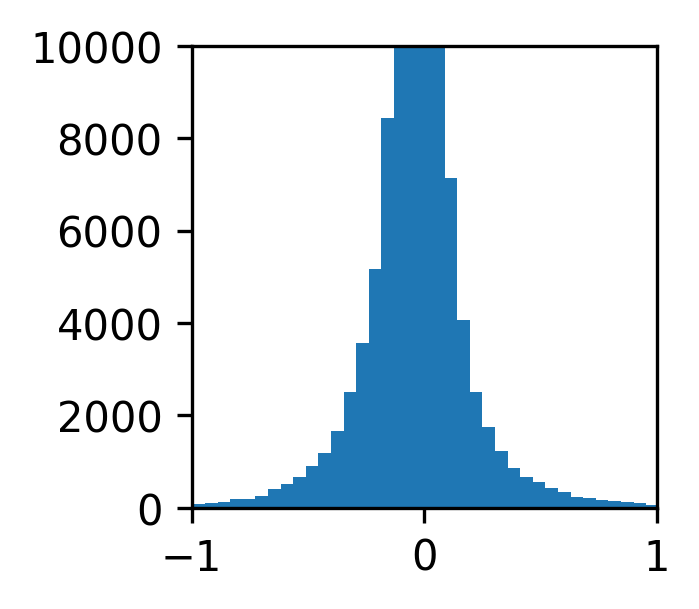

In [6]:
fig = plt.figure(figsize=(2,2))
_=plt.hist(exprData.filter(pl.col("seurat_logFC") != 0)["seurat_logFC"], bins=200)
plt.xlim(-1, 1)
plt.ylim(0, 10000)

(0.0, 10000.0)

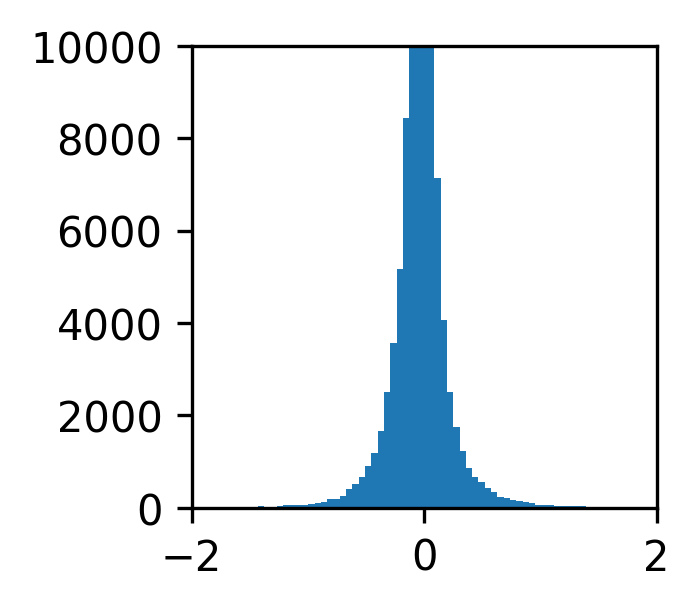

In [7]:
fig = plt.figure(figsize=(2,2))
_=plt.hist(exprData.filter(pl.col("seurat_logFC") != 0)["seurat_logFC"], bins=200)
plt.xlim(-2, 2)
plt.ylim(0, 10000)

In [8]:
bfz = BaseFuzzifier()

In [9]:
allConditions = list(set(exprData["condition"]))

centers [-1.0, -0.5, 0, 0.5, 1.0]
Creating Universe Range -7.0 -> 7.0 with step size 0.1


/mnt/raidbio/extproj/projekte/FlowSets/scanpy_usecase/../flowset.py:659: RuntimeWarning: invalid value encountered in divide
  values = fuzz.trimf(self.universe, abc)/unscaledValues


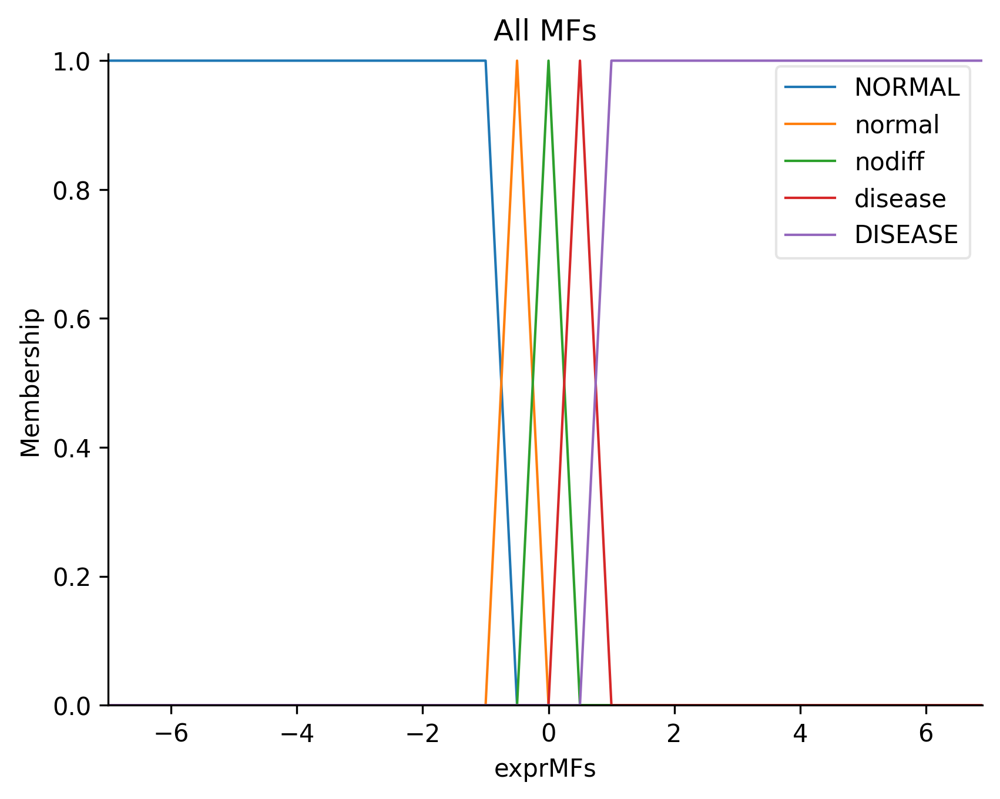

In [10]:
fuzzifiers2 = bfz.make_fuzzy_concepts(exprData,
                                     ["NORMAL", "normal", "nodiff", "disease", "DISEASE"],
                                     [-1.0, -0.5, 0, 0.5, 1.0],
                                     clusterColName="condition",
                                     meancolName="seurat_logFC",
                                     mfLevelsMirrored=True,
                                     stepsize=0.1,
                                     shape="tri",
                                     series=allConditions,
                                     perSeriesFuzzy=False)

centers [-2, -1, 0, 1, 2]
Creating Universe Range -7.0 -> 7.0 with step size 0.1


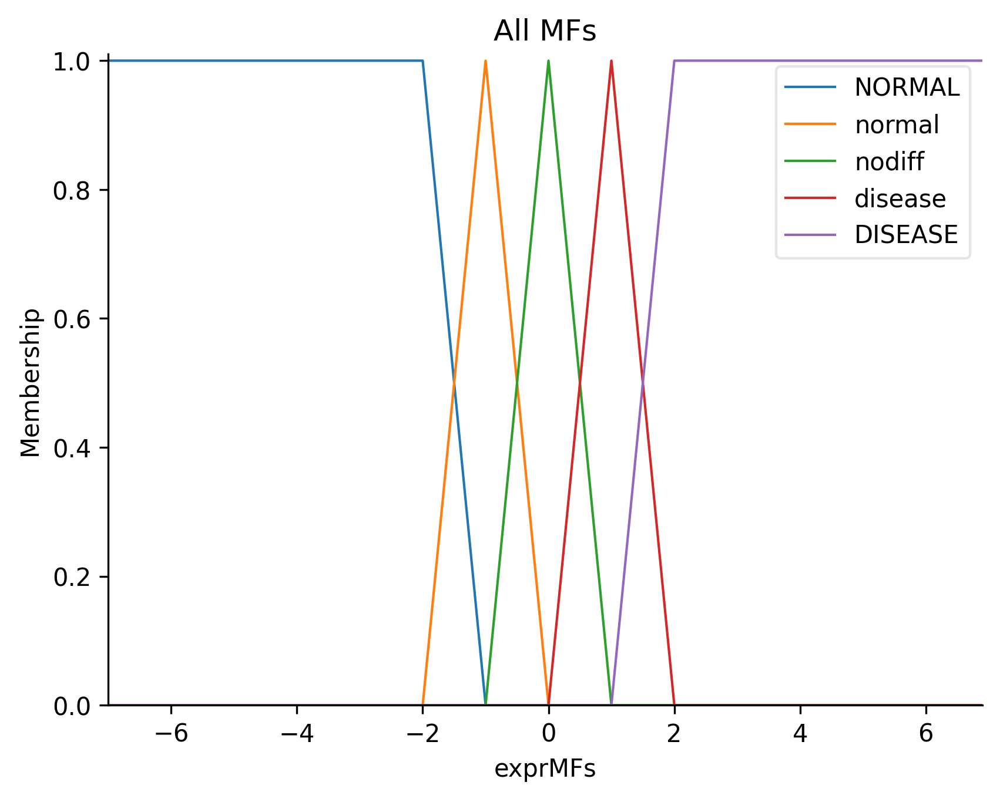

In [11]:
fuzzifiers = bfz.make_fuzzy_concepts(exprData,
                                     ["NORMAL", "normal", "nodiff", "disease", "DISEASE"],
                                     [-2, -1, 0, 1, 2],
                                     clusterColName="condition",
                                     meancolName="seurat_logFC",
                                     mfLevelsMirrored=True,
                                     stepsize=0.1,
                                     shape="tri",
                                     series=allConditions,
                                     perSeriesFuzzy=False)

In [12]:
hlcaFuzzy = bfz.fuzzify(exprData, fuzzifiers2,
                  mean_col = "seurat_logFC", sd_col = "log2fc_mad", expr_col = "disease_expr", cluster_col = "condition", feature_col = "gene")


Processing cluster pneumonia with 1 samples
Processing cluster COVID-19 with 1 samples
Processing cluster lung adenocarcinoma with 1 samples
Processing cluster chronic obstructive pulmonary disease with 1 samples
Processing cluster hypersensitivity pneumonitis with 1 samples
Processing cluster pleomorphic carcinoma with 1 samples
Processing cluster interstitial lung disease with 1 samples
Processing cluster non-specific interstitial pneumonia with 1 samples
Processing cluster pulmonary fibrosis with 1 samples
Processing cluster lung large cell carcinoma with 1 samples
Processing cluster pulmonary sarcoidosis with 1 samples
Processing cluster squamous cell lung carcinoma with 1 samples
Processing cluster lymphangioleiomyomatosis with 1 samples


In [13]:
isgListLong = ("MX1","MX2","MT2A","RSAD2","SIGLEC1","IFIT1","IFI44","IFI27","IFITM10","IFIT3","IFI6","IFIT1P1","IFIT2","IFITM9P","IFI30","IFITM3","IFI44L","IFIT1B","IFITM5","IFITM3P2","IFITM3P9","IFI27L2","IFIT5","IFITM1","IFIH1","IFI16","IFI35","IFI27L1","IRF6","IRF7","IRF9","IRF5","IRF4","IRF2BP2","IRF2BPL","IRF3","IRF1-AS1","ISG15","ISG20L2","ISG20","XAF1","LY6E","IFITM2","IFITM3P6","IFITM3P3","IFIT6P","IRF2BP1","IRF5P1","IRF2","IRF1","IRF8","IFITM3P7","IFITM4P","IFITM3P1","IFITM3P8")
isgListShort = ("MT2A", "ISG15", "LY6E", "IFIT1", "IFIT2", "IFIT3", "IFITM1", "IFITM3", "IFI44L", "IFI6", "MX1", "IFI27",  "IFI44L", "RSAD2", "SIGLEC1", "IFIT1", "ISG15")

In [14]:
fa = FlowAnalysis(hlcaFuzzy, "gene", [(x, x) for x in sorted(allConditions)], fuzzifiers)

In [15]:
import seaborn as sns

scm = fa._create_series_color_map(None, "scaling")
icefires = sns.color_palette("icefire", len(scm)+2)

sc = {x: scm[x](1.0) for xi, x in enumerate(scm)}
#sc = {x: icefires[xi+1] for xi, x in enumerate(scm)}
sc

{'COVID-19': (np.float64(0.267004),
  np.float64(0.004874),
  np.float64(0.329415),
  np.float64(1.0)),
 'chronic obstructive pulmonary disease': (np.float64(0.283091),
  np.float64(0.110553),
  np.float64(0.431554),
  np.float64(1.0)),
 'hypersensitivity pneumonitis': (np.float64(0.271828),
  np.float64(0.209303),
  np.float64(0.504434),
  np.float64(1.0)),
 'interstitial lung disease': (np.float64(0.239346),
  np.float64(0.300855),
  np.float64(0.540844),
  np.float64(1.0)),
 'lung adenocarcinoma': (np.float64(0.203063),
  np.float64(0.379716),
  np.float64(0.553925),
  np.float64(1.0)),
 'lung large cell carcinoma': (np.float64(0.169646),
  np.float64(0.456262),
  np.float64(0.55803),
  np.float64(1.0)),
 'lymphangioleiomyomatosis': (np.float64(0.140536),
  np.float64(0.530132),
  np.float64(0.555659),
  np.float64(1.0)),
 'non-specific interstitial pneumonia': (np.float64(0.120092),
  np.float64(0.600104),
  np.float64(0.54253),
  np.float64(1.0)),
 'pleomorphic carcinoma': (np.flo

In [16]:
fa.plot_flows(transformCounts=lambda x: np.sqrt(x), seriesColors=sc, outfile="per_disease_flowsets/hlca_flows_sqrt")

In [17]:
fa.plot_flows(transformCounts=lambda x: np.log2(x), seriesColors=sc, outfile="per_disease_flowsets/hlca_flows_log")

In [18]:
relations = ["=" for x in list(fa.series2name)[1:]]
maxLevels = ["nodiff" for x in list(fa.series2name)]
minLevels = ["nodiff" for x in list(fa.series2name)]

noChangeEdges = fa.flow_finder(relations, minLevels=minLevels, maxLevels=maxLevels, verbose=True)

12 (('COVID-19', 'nodiff'), ('chronic obstructive pulmonary disease', 'nodiff'))
37 (('chronic obstructive pulmonary disease', 'nodiff'), ('hypersensitivity pneumonitis', 'nodiff'))
62 (('hypersensitivity pneumonitis', 'nodiff'), ('interstitial lung disease', 'nodiff'))
87 (('interstitial lung disease', 'nodiff'), ('lung adenocarcinoma', 'nodiff'))
112 (('lung adenocarcinoma', 'nodiff'), ('lung large cell carcinoma', 'nodiff'))
137 (('lung large cell carcinoma', 'nodiff'), ('lymphangioleiomyomatosis', 'nodiff'))
162 (('lymphangioleiomyomatosis', 'nodiff'), ('non-specific interstitial pneumonia', 'nodiff'))
187 (('non-specific interstitial pneumonia', 'nodiff'), ('pleomorphic carcinoma', 'nodiff'))
212 (('pleomorphic carcinoma', 'nodiff'), ('pneumonia', 'nodiff'))
237 (('pneumonia', 'nodiff'), ('pulmonary fibrosis', 'nodiff'))
262 (('pulmonary fibrosis', 'nodiff'), ('pulmonary sarcoidosis', 'nodiff'))
287 (('pulmonary sarcoidosis', 'nodiff'), ('squamous cell lung carcinoma', 'nodiff'))


In [19]:
focusEdges = [x for x in fa.edgeid2flow if not x in noChangeEdges]

In [20]:
fa.plot_flows(transformCounts=lambda x: np.sqrt(x), use_edges=focusEdges, seriesColors=sc, outfile="per_disease_flowsets/hlca_focus_flows_sqrt")

In [21]:
fa.series2name

{'COVID-19': 'COVID-19',
 'chronic obstructive pulmonary disease': 'chronic obstructive pulmonary disease',
 'hypersensitivity pneumonitis': 'hypersensitivity pneumonitis',
 'interstitial lung disease': 'interstitial lung disease',
 'lung adenocarcinoma': 'lung adenocarcinoma',
 'lung large cell carcinoma': 'lung large cell carcinoma',
 'lymphangioleiomyomatosis': 'lymphangioleiomyomatosis',
 'non-specific interstitial pneumonia': 'non-specific interstitial pneumonia',
 'pleomorphic carcinoma': 'pleomorphic carcinoma',
 'pneumonia': 'pneumonia',
 'pulmonary fibrosis': 'pulmonary fibrosis',
 'pulmonary sarcoidosis': 'pulmonary sarcoidosis',
 'squamous cell lung carcinoma': 'squamous cell lung carcinoma'}

In [22]:
def to_filename(x):
    return x.replace(" ", "_").replace("-", "_")

for x in fa.series2name:
    print(x, to_filename(x))

COVID-19 COVID_19
chronic obstructive pulmonary disease chronic_obstructive_pulmonary_disease
hypersensitivity pneumonitis hypersensitivity_pneumonitis
interstitial lung disease interstitial_lung_disease
lung adenocarcinoma lung_adenocarcinoma
lung large cell carcinoma lung_large_cell_carcinoma
lymphangioleiomyomatosis lymphangioleiomyomatosis
non-specific interstitial pneumonia non_specific_interstitial_pneumonia
pleomorphic carcinoma pleomorphic_carcinoma
pneumonia pneumonia
pulmonary fibrosis pulmonary_fibrosis
pulmonary sarcoidosis pulmonary_sarcoidosis
squamous cell lung carcinoma squamous_cell_lung_carcinoma


COVID-19
['>', '=', '=', '=', '=', '=', '=', '=', '=', '=', '=', '=']
2 (('COVID-19', 'DISEASE'), ('chronic obstructive pulmonary disease', 'nodiff'))
7 (('COVID-19', 'disease'), ('chronic obstructive pulmonary disease', 'nodiff'))
37 (('chronic obstructive pulmonary disease', 'nodiff'), ('hypersensitivity pneumonitis', 'nodiff'))
62 (('hypersensitivity pneumonitis', 'nodiff'), ('interstitial lung disease', 'nodiff'))
87 (('interstitial lung disease', 'nodiff'), ('lung adenocarcinoma', 'nodiff'))
112 (('lung adenocarcinoma', 'nodiff'), ('lung large cell carcinoma', 'nodiff'))
137 (('lung large cell carcinoma', 'nodiff'), ('lymphangioleiomyomatosis', 'nodiff'))
162 (('lymphangioleiomyomatosis', 'nodiff'), ('non-specific interstitial pneumonia', 'nodiff'))
187 (('non-specific interstitial pneumonia', 'nodiff'), ('pleomorphic carcinoma', 'nodiff'))
212 (('pleomorphic carcinoma', 'nodiff'), ('pneumonia', 'nodiff'))
237 (('pneumonia', 'nodiff'), ('pulmonary fibrosis', 'nodiff'))
262 (('pulm

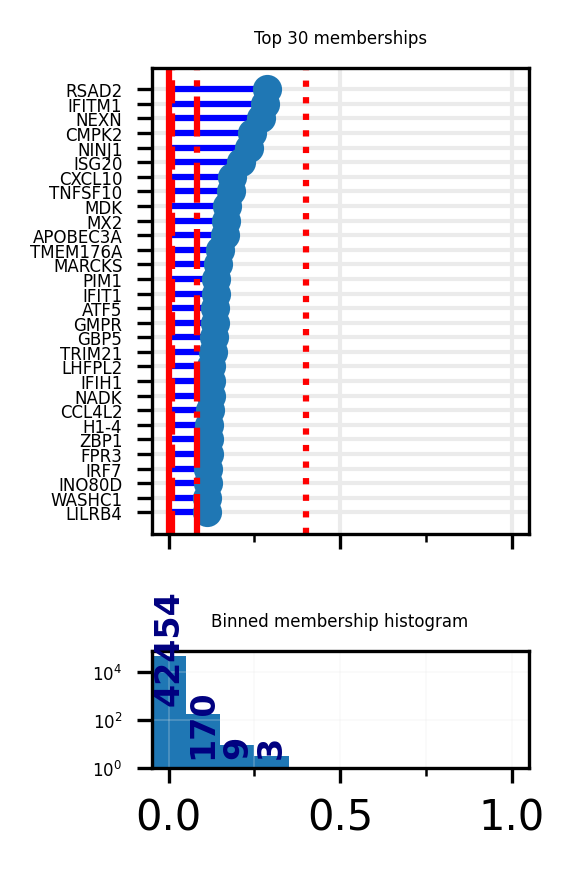

Loading pathways from /mnt/extproj/projekte/FlowSets/endocarditis/go_human.bp.gmt
Identified 12535 pathways
Calculating p-values for groups [2, 5, 10, 50, 100, np.int64(1226)]
            pwid                                             pwname    pwFlow  \
5122   ISG_SHORT                                          ISG_SHORT  0.873595   
2265  GO:0002232  leukocyte chemotaxis involved in inflammatory ...  0.496707   
5123    ISG_LONG                                           ISG_LONG  1.777975   
3203  GO:0043367    CD4-positive, alpha-beta T cell differentiation  0.336483   
1226  GO:0034157  positive regulation of toll-like receptor 7 si...  0.334933   
4389  GO:0035455                       response to interferon-alpha  0.476849   
1984  GO:0035456                        response to interferon-beta  0.473126   
348   GO:0045071    negative regulation of viral genome replication  1.802014   
4240  GO:0034165  positive regulation of toll-like receptor 9 si...  0.286201   
4499  GO:20011

/mnt/raidbio/extproj/projekte/FlowSets/scanpy_usecase/../flowset.py:2868: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


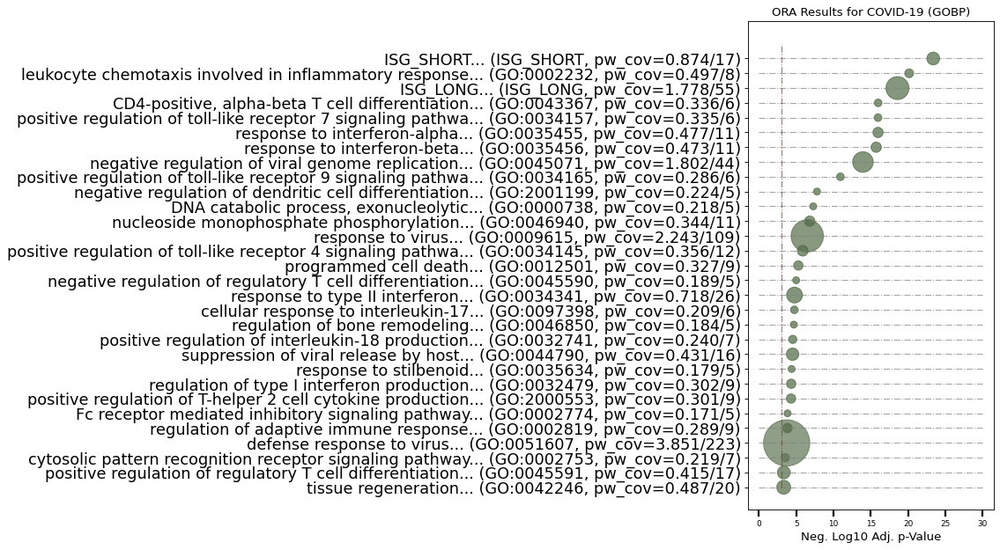

pulmonary sarcoidosis
['=', '=', '=', '=', '=', '=', '=', '=', '=', '=', '<', '>']
12 (('COVID-19', 'nodiff'), ('chronic obstructive pulmonary disease', 'nodiff'))
37 (('chronic obstructive pulmonary disease', 'nodiff'), ('hypersensitivity pneumonitis', 'nodiff'))
62 (('hypersensitivity pneumonitis', 'nodiff'), ('interstitial lung disease', 'nodiff'))
87 (('interstitial lung disease', 'nodiff'), ('lung adenocarcinoma', 'nodiff'))
112 (('lung adenocarcinoma', 'nodiff'), ('lung large cell carcinoma', 'nodiff'))
137 (('lung large cell carcinoma', 'nodiff'), ('lymphangioleiomyomatosis', 'nodiff'))
162 (('lymphangioleiomyomatosis', 'nodiff'), ('non-specific interstitial pneumonia', 'nodiff'))
187 (('non-specific interstitial pneumonia', 'nodiff'), ('pleomorphic carcinoma', 'nodiff'))
212 (('pleomorphic carcinoma', 'nodiff'), ('pneumonia', 'nodiff'))
237 (('pneumonia', 'nodiff'), ('pulmonary fibrosis', 'nodiff'))
260 (('pulmonary fibrosis', 'nodiff'), ('pulmonary sarcoidosis', 'DISEASE'))
26

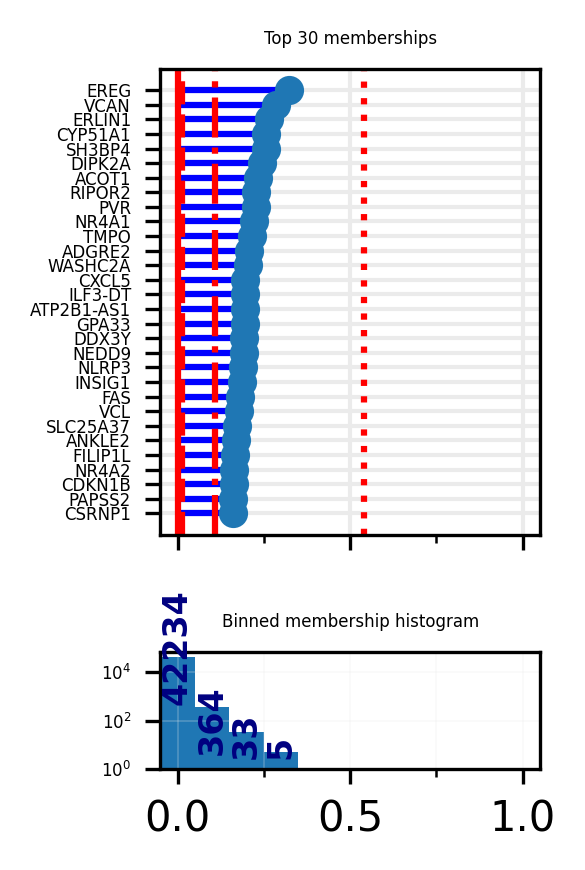

Loading pathways from /mnt/extproj/projekte/FlowSets/endocarditis/go_human.bp.gmt
Identified 12535 pathways
Calculating p-values for groups [2, 5, 10, 50, 100, np.int64(1226)]
            pwid                                             pwname    pwFlow  \
4610  GO:0071376  cellular response to corticotropin-releasing h...  0.468422   
2405  GO:0045540     regulation of cholesterol biosynthetic process  0.485628   
2192  GO:0032933                            SREBP signaling pathway  0.547524   
1803  GO:0007143                    female meiotic nuclear division  0.382364   
1808  GO:0038138                      ERBB4-ERBB4 signaling pathway  0.322843   
1804  GO:0009299                                 mRNA transcription  0.344634   
1805  GO:0030728                                          ovulation  0.425648   
4922  GO:0036010                   protein localization to endosome  0.377757   
3074  GO:0045541  negative regulation of cholesterol biosyntheti...  0.325487   
1807  GO:00381

/mnt/raidbio/extproj/projekte/FlowSets/scanpy_usecase/../flowset.py:2868: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


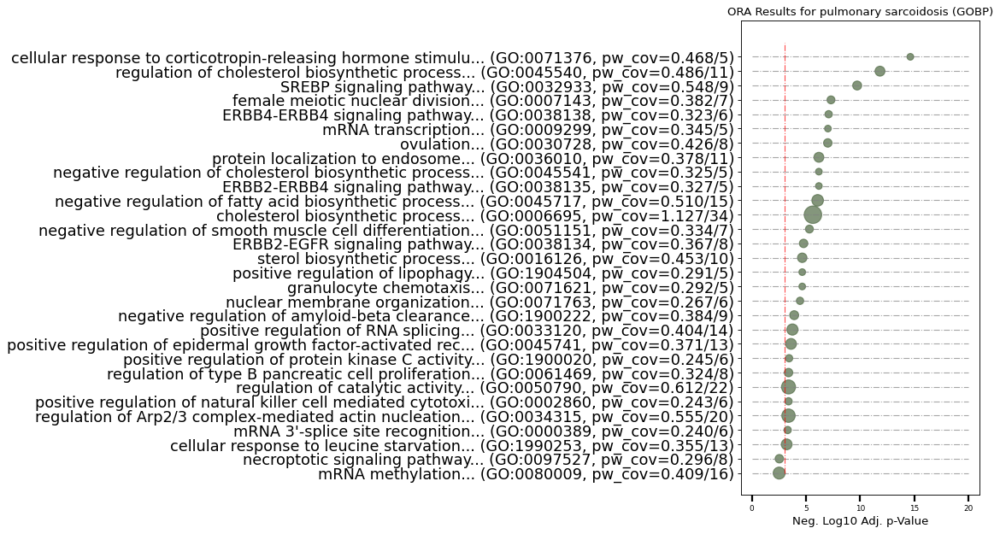

In [23]:
condition2idx = {x: i for i,x in enumerate(fa.series2name)}

for condition in ["COVID-19", "pulmonary sarcoidosis"]: #condition2idx:

    relations = ["=" for x in list(fa.series2name)[1:]]
    maxLevels = ["nodiff" for x in list(fa.series2name)]
    minLevels = ["nodiff" for x in list(fa.series2name)]

    condIdx = condition2idx[condition]
    
    minLevels[condIdx] = None
    maxLevels[condIdx] = None

    if condIdx - 1 >= 0:
        relations[condIdx-1] = "<"

    if condIdx < len(relations):    
        relations[condIdx] = ">"

    print(condition)
    print(relations)
    
    selFlows = fa.flow_finder(relations, minLevels=minLevels, maxLevels=maxLevels, verbose=True)
    
    fa.plot_flows(use_edges=selFlows, transformCounts=lambda x: np.log2(x), seriesColors=sc, outfile="per_disease_flowsets/{}_sqrt_flows".format(to_filename(condition)))
    
    _,_,_ = fa.plot_flow_memberships(selFlows,figsize=(2, 3), outfile="per_disease_flowsets/{}_membership".format(to_filename(condition)))

    oraDF = fa.analyse_pathways(selFlows, genesets_file="/mnt/extproj/projekte/FlowSets/endocarditis/go_human.bp.gmt",
                                set_size_threshold=[ 2,5, 10, 50, 100], minSetSize=5,
                                additional_genesets=[("ISG_SHORT", isgListShort), ("ISG_LONG", isgListLong)])
    
    oraDF = oraDF.sort_values(["pw_coverage_adj_pval"])
    print(oraDF.head(20))
    fa.plotORAresult(oraDF, title="ORA Results for {} (GOBP)".format(condition), figsize=(4.5,9), numResults=30, outfile="per_disease_flowsets/{}_ora".format(to_filename(condition)),
                     entryformat="{x:.60}...{sep}({y}, pw_cov={z:.3f}/{s})")